# **Phase 1**

## **Libraries**

In [1]:
import os
import numpy as np
import pandas as pd
import copy
import cv2
import math
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
from torch import optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, models
import torch.nn.functional as F

## **Load Data**

In [2]:
# Configuration
DATA_DIR = '/kaggle/input/caltech-101/caltech101'
LR = 1e-4
BATCH_SIZE = 32
EPOCHS = 15
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [3]:
def create_dataframe(data_dir):
    images, labels = [], []
    folders = os.listdir(data_dir)
    for folder in folders:
        foldpath = os.path.join(data_dir, folder)
        files = os.listdir(foldpath)
        for file in files:
            img = os.path.join(foldpath, file)
            images.append(img)
            labels.append(folder)

    return pd.DataFrame({"images":images,"labels":labels})

df = create_dataframe(DATA_DIR)
df.head()

,images,labels
0,/kaggle/input/caltech-101/caltech101/scorpion/...,scorpion
1,/kaggle/input/caltech-101/caltech101/scorpion/...,scorpion
2,/kaggle/input/caltech-101/caltech101/scorpion/...,scorpion
3,/kaggle/input/caltech-101/caltech101/scorpion/...,scorpion
4,/kaggle/input/caltech-101/caltech101/scorpion/...,scorpion


In [4]:
df['labels'].value_counts()

labels
airplanes       800
Motorbikes      798
Faces_easy      435
Faces           435
watch           239
               ... 
wild_cat         34
garfield         34
binocular        33
metronome        32
inline_skate     31
Name: count, Length: 101, dtype: int64

In [5]:
train, temp = train_test_split(df, test_size=0.3,random_state=42,stratify=df['labels'])
test, valid = train_test_split(temp, test_size=0.5,random_state=42,stratify=temp['labels'])
print(f'Shape of dataframes:\n{train.shape}\n{test.shape}\n{valid.shape}')

Shape of dataframes:
(6073, 2)
(1302, 2)
(1302, 2)


## **DataSet & DataLoader**

In [6]:
le = LabelEncoder()
le.fit(df['labels'])
classes = list(le.classes_)
label_map = {c: i for i, c in enumerate(classes)}
num_classes = len(classes)

In [7]:
MEAN = [0.485, 0.456, 0.406]
STD  = [0.229, 0.224, 0.225]

train_tfms = transforms.Compose([
    transforms.RandomResizedCrop(224, scale=(0.8, 1.0)),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(),
    transforms.Normalize(mean=MEAN,
                         std=STD),
])

eval_tfms = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=MEAN,
                         std=STD),
])

In [8]:
class CustomImageDataset(Dataset):
    def __init__(self, df, transform, label_map):
        self.df = df.reset_index(drop=True)
        self.transform = transform
        self.label_map = label_map

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        img = Image.open(row['images']).convert('RGB')
        if self.transform:
            img = self.transform(img)
        label = torch.tensor(self.label_map[row['labels']], dtype=torch.long)
        return img, label

train_dataset = CustomImageDataset(train, train_tfms, label_map)
val_dataset   = CustomImageDataset(valid, eval_tfms,  label_map)
test_dataset  = CustomImageDataset(test,  eval_tfms,  label_map)

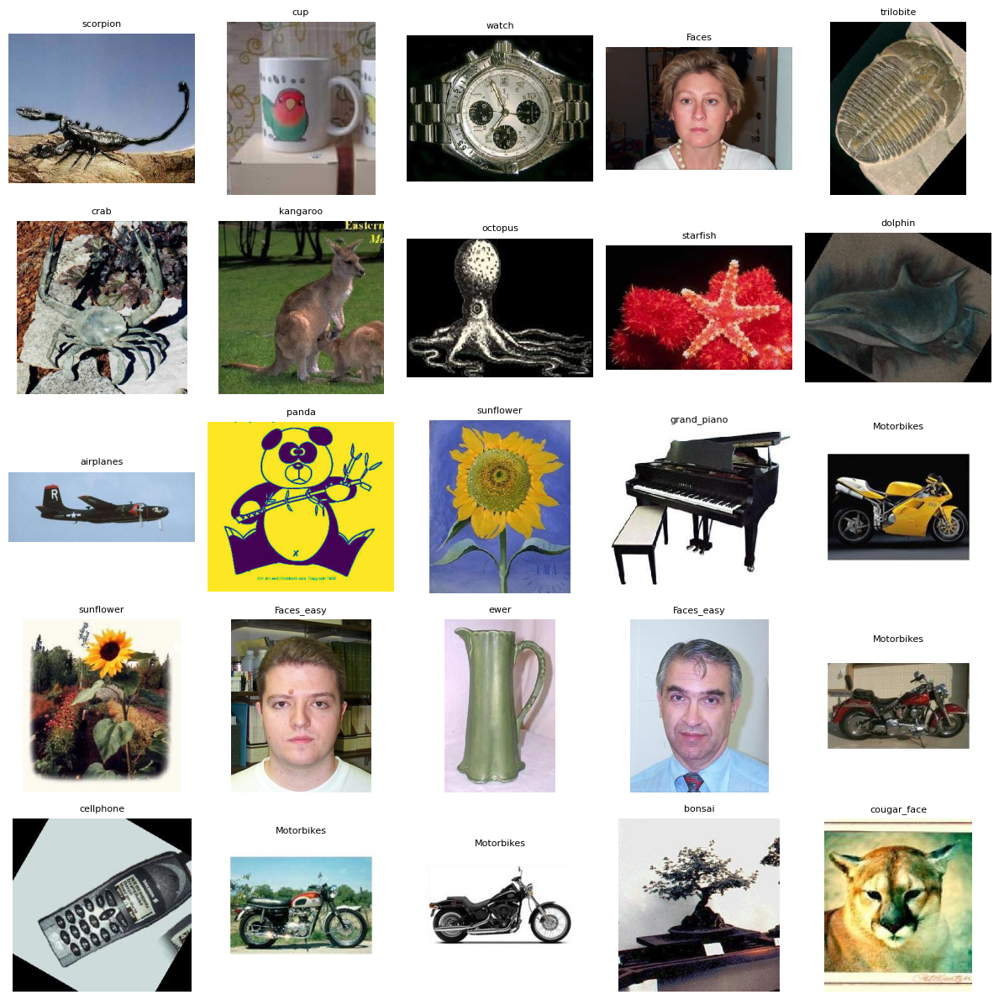

In [9]:
# Visualize some samples
n = 5
fig, ax = plt.subplots(n, n, figsize=(12, 12))

for row in range(n):
    for col in range(n):
        sample = df.sample(n=1).iloc[0]
        img_path = sample['images']
        label = sample['labels']  

        img = Image.open(img_path)
        ax[row, col].imshow(img)
        ax[row, col].set_title(str(label), fontsize=8)
        ax[row, col].axis('off')

plt.tight_layout()
plt.show()

In [10]:
# DataLoader
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader   = DataLoader(val_dataset,   batch_size=BATCH_SIZE, shuffle=False)
test_loader  = DataLoader(test_dataset,  batch_size=BATCH_SIZE, shuffle=False)

## **Models**

In [11]:
resnet = models.resnet34(weights=models.ResNet34_Weights.IMAGENET1K_V1)

for p in resnet.parameters(): p.requires_grad = False
for p in resnet.layer4.parameters(): p.requires_grad = True  

resnet.fc = nn.Linear(resnet.fc.in_features, num_classes)
resnet = resnet.to(device)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth
100%|██████████| 83.3M/83.3M [00:00<00:00, 205MB/s]


In [12]:
mobilenet = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.IMAGENET1K_V1)

for p in mobilenet.parameters(): p.requires_grad = False
for p in mobilenet.features[-1].parameters(): p.requires_grad = True  

mobilenet.classifier[1] = nn.Linear(mobilenet.classifier[1].in_features, num_classes)
mobilenet = mobilenet.to(device)

Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth
100%|██████████| 13.6M/13.6M [00:00<00:00, 143MB/s]


In [13]:
def train_model(model, train_loader, val_loader, criterion, optimizer, num_epochs, model_name="model"):
    history = {
        "train_loss": [],
        "val_loss": [],
        "train_acc": [],
        "val_acc": []
    }
    
    best_val_acc = 0.0
    best_model_wts = None

    for epoch in range(num_epochs):
        # Training phase
        model.train()
        total_loss_train = 0
        total_acc_train = 0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            total_loss_train += loss.item() * inputs.size(0)
            loss.backward()
            optimizer.step()
            total_acc_train += (torch.argmax(outputs, dim=1) == labels).sum().item()
        
        total_loss_train /= len(train_loader.dataset)
        total_acc_train = 100 * total_acc_train / len(train_loader.dataset)

        # Validation phase
        model.eval()
        total_loss_val = 0
        total_acc_val = 0
        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                val_loss = criterion(outputs, labels)
                total_loss_val += val_loss.item() * inputs.size(0)
                total_acc_val += (torch.argmax(outputs, dim=1) == labels).sum().item()
        
        total_loss_val /= len(val_loader.dataset)
        total_acc_val = 100 * total_acc_val / len(val_loader.dataset)

        # Save history
        history["train_loss"].append(total_loss_train)
        history["val_loss"].append(total_loss_val)
        history["train_acc"].append(total_acc_train)
        history["val_acc"].append(total_acc_val)

        # Print progress
        print(f"[{model_name}] Epoch {epoch+1}/{num_epochs} | "
              f"Train Loss: {total_loss_train:.4f}, Train Acc: {total_acc_train:.2f}% | "
              f"Val Loss: {total_loss_val:.4f}, Val Acc: {total_acc_val:.2f}%")

        # Save best model
        if total_acc_val > best_val_acc:
            best_val_acc = total_acc_val
            best_model_wts = model.state_dict().copy()
            torch.save(best_model_wts, f"best_{model_name}.pth")
            print(f">>> Saved new best {model_name} with Val Acc: {best_val_acc:.2f}%")
        print("-"*50)
    
    # Load best model weights
    if best_model_wts is not None:
        model.load_state_dict(best_model_wts)
        print(f"\nFinal {model_name} loaded with Best Val Acc = {best_val_acc:.2f}%")

    return model, history

In [14]:
def plot_training(history, model_name="model"):
    fig, axs = plt.subplots(1, 2, figsize=(15, 5))

    axs[0].plot(history["train_loss"], label="Train Loss")
    axs[0].plot(history["val_loss"], label="Validation Loss")
    axs[0].set_title(f'{model_name} Loss')
    axs[0].set_xlabel('Epochs')
    axs[0].set_ylabel('Loss')
    axs[0].legend()

    axs[1].plot(history["train_acc"], label="Train Acc")
    axs[1].plot(history["val_acc"], label="Validation Acc")
    axs[1].set_title(f'{model_name} Accuracy')
    axs[1].set_xlabel('Epochs')
    axs[1].set_ylabel('Accuracy')
    axs[1].legend()

    plt.tight_layout()
    plt.show()

In [15]:
def evaluate_model(model, test_loader, criterion, model_name="model"):
    model.eval()
    total_loss = 0
    total_acc = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            total_loss += loss.item() * inputs.size(0)
            total_acc += (torch.argmax(outputs, dim=1) == labels).sum().item()
    
    avg_loss = total_loss / len(test_loader.dataset)
    avg_acc = 100 * total_acc / len(test_loader.dataset)
    print(f"[{model_name}] Test Accuracy: {avg_acc:.2f}% | Test Loss: {avg_loss:.4f}")

In [16]:
criterion = nn.CrossEntropyLoss()

[ResNet34] Epoch 1/15 | Train Loss: 1.4524, Train Acc: 73.52% | Val Loss: 0.5447, Val Acc: 88.86%
>>> Saved new best ResNet34 with Val Acc: 88.86%
--------------------------------------------------
[ResNet34] Epoch 2/15 | Train Loss: 0.2480, Train Acc: 96.38% | Val Loss: 0.3803, Val Acc: 89.71%
>>> Saved new best ResNet34 with Val Acc: 89.71%
--------------------------------------------------
[ResNet34] Epoch 3/15 | Train Loss: 0.1019, Train Acc: 98.70% | Val Loss: 0.4407, Val Acc: 89.94%
>>> Saved new best ResNet34 with Val Acc: 89.94%
--------------------------------------------------
[ResNet34] Epoch 4/15 | Train Loss: 0.0535, Train Acc: 99.42% | Val Loss: 0.4327, Val Acc: 89.94%
--------------------------------------------------
[ResNet34] Epoch 5/15 | Train Loss: 0.0388, Train Acc: 99.59% | Val Loss: 0.4243, Val Acc: 90.40%
>>> Saved new best ResNet34 with Val Acc: 90.40%
--------------------------------------------------
[ResNet34] Epoch 6/15 | Train Loss: 0.0282, Train Acc: 99.4

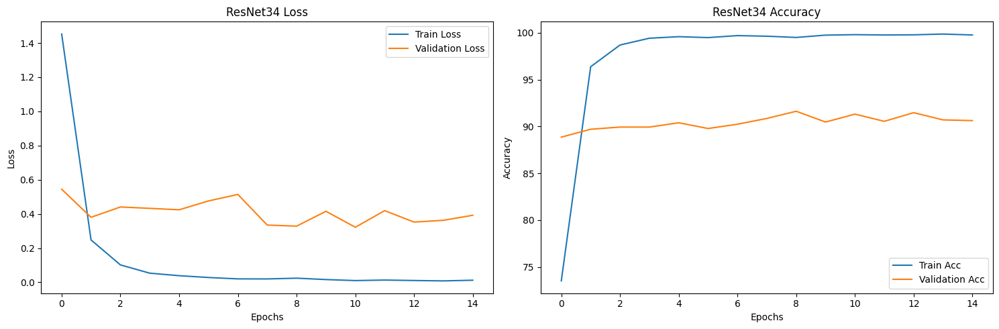

[ResNet34] Test Accuracy: 89.94% | Test Loss: 0.4328


In [17]:
# Train ResNet
resnet_optimizer = optim.Adam(filter(lambda p: p.requires_grad, resnet.parameters()), lr=LR)
resnet, resnet_history = train_model(resnet, train_loader, val_loader, criterion, resnet_optimizer, EPOCHS, "ResNet34")
plot_training(resnet_history, "ResNet34")
evaluate_model(resnet, test_loader, criterion, "ResNet34")

[MobileNetV2] Epoch 1/15 | Train Loss: 3.6107, Train Acc: 26.26% | Val Loss: 3.0178, Val Acc: 34.41%
>>> Saved new best MobileNetV2 with Val Acc: 34.41%
--------------------------------------------------
[MobileNetV2] Epoch 2/15 | Train Loss: 2.7099, Train Acc: 44.74% | Val Loss: 2.4582, Val Acc: 54.61%
>>> Saved new best MobileNetV2 with Val Acc: 54.61%
--------------------------------------------------
[MobileNetV2] Epoch 3/15 | Train Loss: 2.2505, Train Acc: 60.66% | Val Loss: 2.0939, Val Acc: 63.75%
>>> Saved new best MobileNetV2 with Val Acc: 63.75%
--------------------------------------------------
[MobileNetV2] Epoch 4/15 | Train Loss: 1.9136, Train Acc: 69.69% | Val Loss: 1.7932, Val Acc: 69.97%
>>> Saved new best MobileNetV2 with Val Acc: 69.97%
--------------------------------------------------
[MobileNetV2] Epoch 5/15 | Train Loss: 1.6471, Train Acc: 75.40% | Val Loss: 1.5760, Val Acc: 74.73%
>>> Saved new best MobileNetV2 with Val Acc: 74.73%
-------------------------------

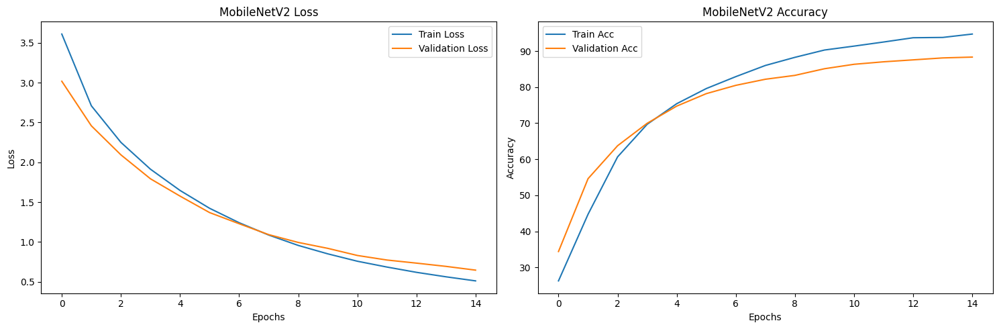

[MobileNetV2] Test Accuracy: 85.64% | Test Loss: 0.6933


In [18]:
# Train MobileNet
mobilenet_optimizer = optim.Adamax(filter(lambda p: p.requires_grad, mobilenet.parameters()), lr=LR)
mobilenet, mobilenet_history = train_model(mobilenet, train_loader, val_loader, criterion, mobilenet_optimizer, EPOCHS, "MobileNetV2")
plot_training(mobilenet_history, "MobileNetV2")
evaluate_model(mobilenet, test_loader, criterion, "MobileNetV2")

# **Phase 2**

In [19]:
MEAN_2 = torch.tensor(MEAN, device=device).view(1, 3, 1, 1)
STD_2  = torch.tensor(STD, device=device).view(1, 3, 1, 1)

def clamp_normalized(x):
    x_min = (0.0 - MEAN_2) / STD_2
    x_max = (1.0 - MEAN_2) / STD_2
    return torch.max(torch.min(x, x_max), x_min)

In [20]:
def fgsm_attack(model, images, labels, epsilon, loss_fn):
    images = images.clone().detach().to(device)
    labels = labels.clone().detach().to(device)
    images.requires_grad = True

    outputs = model(images)
    loss = loss_fn(outputs, labels)
    model.zero_grad()
    loss.backward()

    data_grad = images.grad.data
    perturbed_images = images + epsilon * data_grad.sign()
    perturbed_images = torch.clamp(perturbed_images, 0, 1)

    noise = perturbed_images - images
    return perturbed_images.detach(), noise.detach()

In [21]:
def evaluate_under_attack(model, loader, epsilons, loss_fn, max_batches=None):
    model.eval()
    acc, asr = {}, {}
    
    clean_preds = []
    clean_labels = []
    for b, (x, y) in enumerate(loader):
        if max_batches is not None and b >= max_batches: break
        x, y = x.to(device), y.to(device)
        with torch.no_grad():
            logits = model(x)
            clean_preds.append(logits.argmax(1))
            clean_labels.append(y.clone())
    clean_preds = torch.cat(clean_preds, dim=0)
    clean_labels = torch.cat(clean_labels, dim=0)

    for eps in epsilons:
        total_correct = 0
        total = 0
        total_success = 0
        offset = 0
        for b, (x, y) in enumerate(loader):
            if max_batches is not None and b >= max_batches: break
            x, y = x.to(device), y.to(device)
            x_adv, _ = fgsm_attack(model, x, y, eps, loss_fn)
            logits_adv = model(x_adv)
            pred_adv = logits_adv.argmax(1)

            # Accuracy under attack
            total_correct += (pred_adv == y).sum().item()
            total += y.numel()

            # ASR relative to clean predictions for this slice
            k = y.size(0)
            pred_clean_slice = clean_preds[offset:offset+k]
            total_success += (pred_adv != pred_clean_slice.to(device)).sum().item()
            offset += k

        acc[eps] = 100.0 * total_correct / total
        asr[eps] = 100.0 * total_success / total
        print(f"Epsilon={eps:.4f} | Adv Acc: {acc[eps]:.2f}% | ASR: {asr[eps]:.2f}%")

In [22]:
def unnormalize(tensor, mean=MEAN_2, std=STD_2):
    if not torch.is_tensor(tensor):
        raise TypeError("Input must be a torch tensor")

    mean = torch.tensor(mean).view(-1, 1, 1).to(tensor.device)
    std = torch.tensor(std).view(-1, 1, 1).to(tensor.device)
    return tensor * std + mean

def show_adversarial_examples(model, loader, epsilon, classes, n=6):
    model.to(device).eval()
    x, y = next(iter(loader))
    x, y = x.to(device), y.to(device)

    # Craft adversarial examples
    x_adv, _ = fgsm_attack(model, x, y, epsilon, nn.CrossEntropyLoss())

    with torch.no_grad():
        logits_clean = model(x)
        logits_adv = model(x_adv)
        pc = logits_clean.softmax(1)
        pa = logits_adv.softmax(1)

    # Random subset
    idxs = torch.randperm(x.size(0))[:n]
    cols = 3
    rows = n
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 3))

    if rows == 1:
        axes = np.expand_dims(axes, 0)

    for r, i in enumerate(idxs):
        # Unnormalize
        img_c = unnormalize(x[i]).clamp(0, 1)
        img_a = unnormalize(x_adv[i]).clamp(0, 1)

        # Convert to numpy (RGB or Gray)
        if img_c.dim() == 3 and img_c.size(0) >= 3:  
            img_c = img_c[:3].permute(1, 2, 0).cpu().numpy()
            img_a = img_a[:3].permute(1, 2, 0).cpu().numpy()
        elif img_c.dim() == 2:  
            img_c = img_c.cpu().numpy()
            img_a = img_a.cpu().numpy()
        else:
            raise ValueError(f"Unexpected image shape: {img_c.shape}")

        # Perturbation visualization (scaled)
        diff = np.abs(img_a - img_c)
        diff /= diff.max() + 1e-8

        yc = logits_clean[i].argmax().item()
        ya = logits_adv[i].argmax().item()
        conf_c = pc[i, yc].item()
        conf_a = pa[i, ya].item()

        axes[r, 0].imshow(img_c)
        axes[r, 0].set_title(f"Clean: {classes[yc]} ({conf_c:.2f})", fontsize=9)
        axes[r, 1].imshow(img_a)
        axes[r, 1].set_title(f"Adv: {classes[ya]} ({conf_a:.2f})", fontsize=9)
        axes[r, 2].imshow(diff)
        axes[r, 2].set_title("Perturbation", fontsize=9)

        for c in range(cols):
            axes[r, c].axis("off")

    plt.tight_layout()
    plt.show()

In [25]:
epsilons = [0.0, 0.001, 0.002, 0.004, 0.008, 0.012, 0.016, 0.02, 0.03, 0.04, 0.06, 0.08, 0.1,0.2,0.3]

print("\n--- ResNet-34 under FGSM ---")
evaluate_under_attack(resnet, test_loader, epsilons, criterion)


--- ResNet-34 under FGSM ---
Epsilon=0.0000 | Adv Acc: 60.45% | ASR: 41.01%
Epsilon=0.0010 | Adv Acc: 59.83% | ASR: 41.63%
Epsilon=0.0020 | Adv Acc: 59.52% | ASR: 41.94%
Epsilon=0.0040 | Adv Acc: 58.45% | ASR: 42.70%
Epsilon=0.0080 | Adv Acc: 56.45% | ASR: 44.16%
Epsilon=0.0120 | Adv Acc: 54.45% | ASR: 45.93%
Epsilon=0.0160 | Adv Acc: 52.92% | ASR: 47.00%
Epsilon=0.0200 | Adv Acc: 51.84% | ASR: 47.70%
Epsilon=0.0300 | Adv Acc: 47.47% | ASR: 51.61%
Epsilon=0.0400 | Adv Acc: 44.85% | ASR: 54.30%
Epsilon=0.0600 | Adv Acc: 40.78% | ASR: 58.37%
Epsilon=0.0800 | Adv Acc: 38.33% | ASR: 61.14%
Epsilon=0.1000 | Adv Acc: 35.87% | ASR: 64.21%
Epsilon=0.2000 | Adv Acc: 28.65% | ASR: 73.66%
Epsilon=0.3000 | Adv Acc: 23.73% | ASR: 79.49%


In [26]:
print("\n--- MobileNetV2 under FGSM ---")
evaluate_under_attack(mobilenet, test_loader, epsilons, criterion)


--- MobileNetV2 under FGSM ---
Epsilon=0.0000 | Adv Acc: 52.61% | ASR: 51.15%
Epsilon=0.0010 | Adv Acc: 51.92% | ASR: 51.69%
Epsilon=0.0020 | Adv Acc: 51.31% | ASR: 52.00%
Epsilon=0.0040 | Adv Acc: 50.61% | ASR: 52.38%
Epsilon=0.0080 | Adv Acc: 48.69% | ASR: 54.30%
Epsilon=0.0120 | Adv Acc: 46.31% | ASR: 56.14%
Epsilon=0.0160 | Adv Acc: 44.62% | ASR: 57.76%
Epsilon=0.0200 | Adv Acc: 43.16% | ASR: 58.99%
Epsilon=0.0300 | Adv Acc: 40.86% | ASR: 60.98%
Epsilon=0.0400 | Adv Acc: 37.86% | ASR: 64.13%
Epsilon=0.0600 | Adv Acc: 34.49% | ASR: 67.43%
Epsilon=0.0800 | Adv Acc: 30.72% | ASR: 71.66%
Epsilon=0.1000 | Adv Acc: 27.19% | ASR: 74.73%
Epsilon=0.2000 | Adv Acc: 14.67% | ASR: 85.18%
Epsilon=0.3000 | Adv Acc: 9.83% | ASR: 89.48%


/tmp/ipykernel_36/3985976811.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1).to(tensor.device)
/tmp/ipykernel_36/3985976811.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std = torch.tensor(std).view(-1, 1, 1).to(tensor.device)


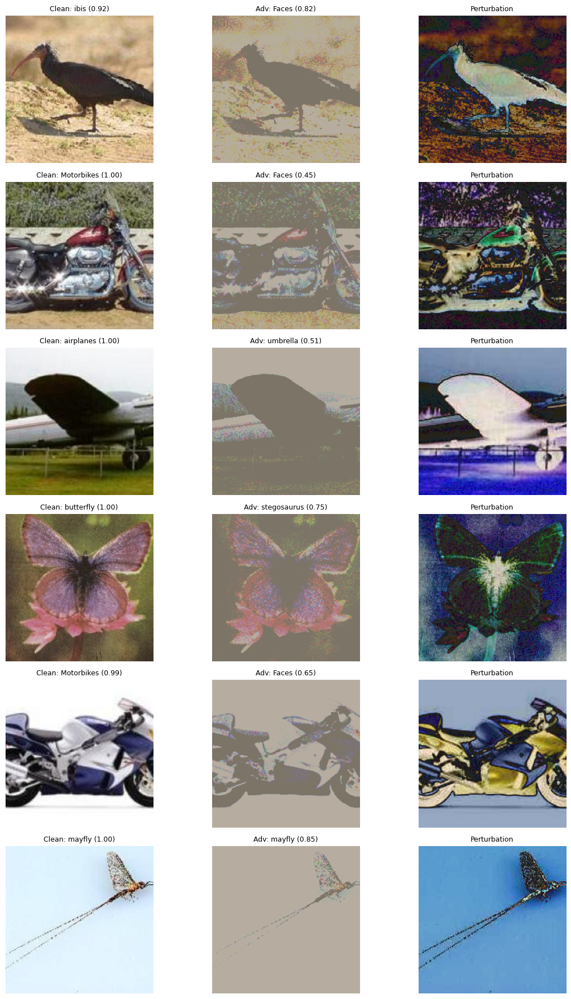

In [27]:
show_adversarial_examples(resnet, test_loader, epsilon=0.3, classes=classes)

/tmp/ipykernel_36/3985976811.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1).to(tensor.device)
/tmp/ipykernel_36/3985976811.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std = torch.tensor(std).view(-1, 1, 1).to(tensor.device)


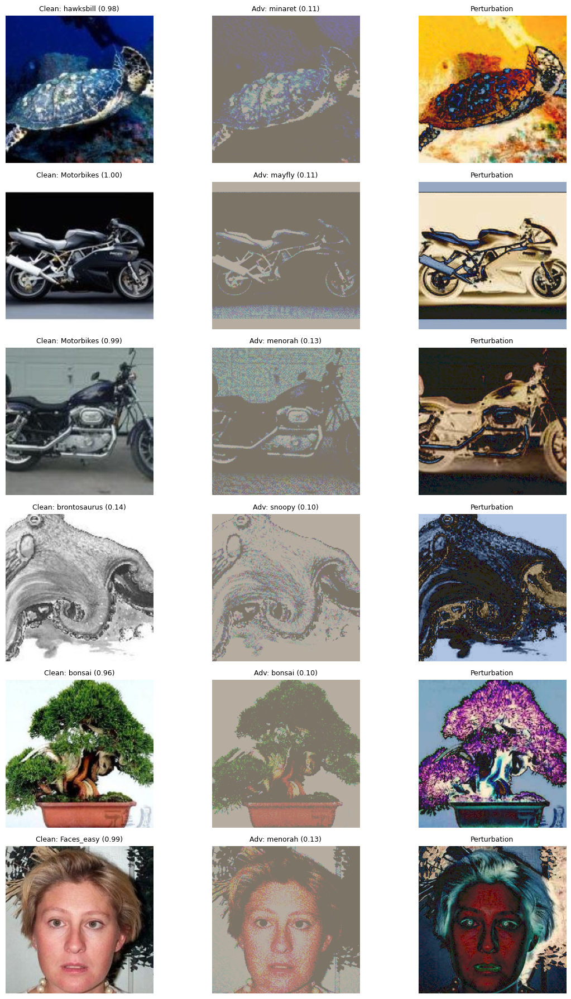

In [28]:
show_adversarial_examples(mobilenet, test_loader, epsilon=0.3, classes=classes)

# **Phase 3**

In [29]:
def preprocess_image(img_path):
    tfms = transforms.Compose([
        transforms.Resize((224,224)),
        transforms.ToTensor(),
        transforms.Normalize(mean=MEAN, std=STD)
    ])

    img = Image.open(img_path).convert('RGB')
    img_tensor = tfms(img).unsqueeze(0).to(device)
    return img_tensor, img

In [30]:
def generate_saliency_map(model, img_tensor, class_idx=None):
    model.eval()
    # Clone the tensor and enable gradient tracking
    img_tensor = img_tensor.clone().detach().requires_grad_(True)

    # Forward pass
    output = model(img_tensor)
    if class_idx is None:
        # If no class index provided, take the predicted one
        class_idx = output.argmax(dim=1).item()

    # Backward pass for the target class score
    score = output[0, class_idx]
    model.zero_grad()
    score.backward()

    # Compute saliency as the absolute value of gradients
    saliency = img_tensor.grad.data.abs().squeeze().cpu()
    saliency_max = saliency.max(dim=0)[0]

    # Normalize between 0 and 1 (safe division)
    denom = saliency_max.max() - saliency_max.min()
    saliency_map = (saliency_max - saliency_max.min()) / (denom + 1e-8)

    return saliency_map.numpy()

In [31]:
def generate_gradcam(model, img_tensor, class_idx=None, target_layer='layer4'):
    model.eval()
    activations = []
    gradients = []

    # Hook to save forward activations
    def forward_hook(module, input, output):
        activations.append(output)

    # Hook to save backward gradients
    def backward_hook(module, grad_in, grad_out):
        gradients.append(grad_out[0])

    # Ensure target layer exists in model
    modules_dict = dict([*model.named_modules()])
    if target_layer not in modules_dict:
        raise ValueError(f"Layer '{target_layer}' not found in model. "
                         f"Available layers: {list(modules_dict.keys())[:50]}...")

    layer = modules_dict[target_layer]

    # Register hooks
    handle_fwd = layer.register_forward_hook(forward_hook)
    handle_bwd = layer.register_backward_hook(backward_hook)

    # Forward pass
    output = model(img_tensor)
    if class_idx is None:
        class_idx = output.argmax(dim=1).item()

    # Backward pass for target class
    score = output[0, class_idx]
    model.zero_grad()
    score.backward()

    # Remove hooks to avoid memory leaks
    handle_fwd.remove()
    handle_bwd.remove()

    # Get saved gradients and activations
    grad = gradients[0].cpu().squeeze()
    act = activations[0].cpu().squeeze()

    # Global Average Pooling over gradients to get weights
    weights = grad.mean(dim=(1, 2))
    cam = torch.zeros(act.shape[1:], dtype=torch.float32)

    # Weighted sum of activations
    for i, w in enumerate(weights):
        cam += w * act[i]

    # ReLU (remove negative values) and normalize
    cam = np.maximum(cam.detach().cpu().numpy(), 0)
    cam = cv2.resize(cam, (224, 224))
    cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)

    return cam

In [32]:
def overlay_heatmap(img, heatmap, alpha=0.6):
    # Resize image and heatmap
    img_resized = img.resize((224, 224))
    img_np = np.array(img_resized).astype(np.float32)

    # Normalize and convert heatmap to grayscale
    heatmap = np.clip(heatmap, 0, 1)
    heatmap_gray = np.uint8(255 * heatmap)
    heatmap_gray_3ch = cv2.merge([heatmap_gray]*3).astype(np.float32)

    # Optional: darken image slightly
    img_dark = img_np * 0.7

    # Blend
    overlay = cv2.addWeighted(img_dark, 1 - alpha, heatmap_gray_3ch, alpha, 0)
    overlay = np.clip(overlay, 0, 255).astype(np.uint8)

    return overlay

In [33]:
def explain_prediction(model, img_input, classes, method='saliency', target_layer='layer4', alpha=0.6):
    # Accept either a path or a tensor
    if isinstance(img_input, torch.Tensor):
        # Remove extra singleton dims until we have (C,H,W) or (B,C,H,W)
        while img_input.dim() > 4:
            img_input = img_input.squeeze(0)
        if img_input.dim() == 3:
            img_tensor = img_input.unsqueeze(0).to(device)
        else:
            img_tensor = img_input.to(device)
        # Create PIL image for overlay
        img = transforms.ToPILImage()(unnormalize(img_tensor[0]).cpu())
    else:
        img_tensor, img = preprocess_image(img_input)

    model.eval()
    output = model(img_tensor)
    class_idx = output.argmax(dim=1).item()
    class_name = classes[class_idx]

    # Generate heatmap
    if method == 'saliency':
        heatmap = generate_saliency_map(model, img_tensor, class_idx)
    elif method == 'gradcam':
        heatmap = generate_gradcam(model, img_tensor, class_idx, target_layer)
    else:
        raise ValueError("Method must be 'saliency' or 'gradcam'")

    # Overlay
    img_resized = img.resize((224, 224))
    img_np = np.array(img_resized).astype(np.float32)
    heatmap = np.clip(heatmap, 0, 1)
    heatmap_gray = np.uint8(255 * heatmap)
    heatmap_gray_3ch = cv2.merge([heatmap_gray]*3).astype(np.float32)
    img_dark = img_np * 0.7
    overlay = cv2.addWeighted(img_dark, 1 - alpha, heatmap_gray_3ch, alpha, 0)
    overlay = np.clip(overlay, 0, 255).astype(np.uint8)

    # Display
    fig, axs = plt.subplots(1, 3, figsize=(15, 5))
    axs[0].imshow(img_resized); axs[0].set_title("Original Image"); axs[0].axis('off')
    axs[1].imshow(overlay); axs[1].set_title(f"{method.upper()} Overlay\nPredicted: {class_name}"); axs[1].axis('off')
    axs[2].imshow(heatmap_gray, cmap='gray'); axs[2].set_title("Raw Heatmap"); axs[2].axis('off')
    plt.tight_layout()
    plt.show()

    return overlay

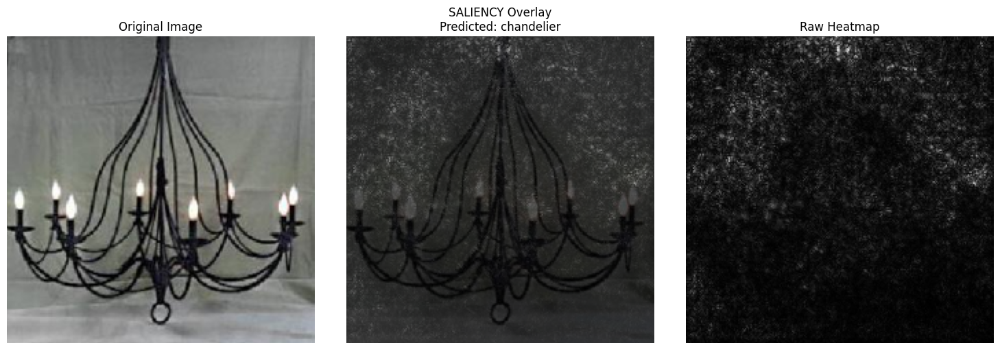

/usr/local/lib/python3.11/dist-packages/torch/nn/modules/module.py:1830: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


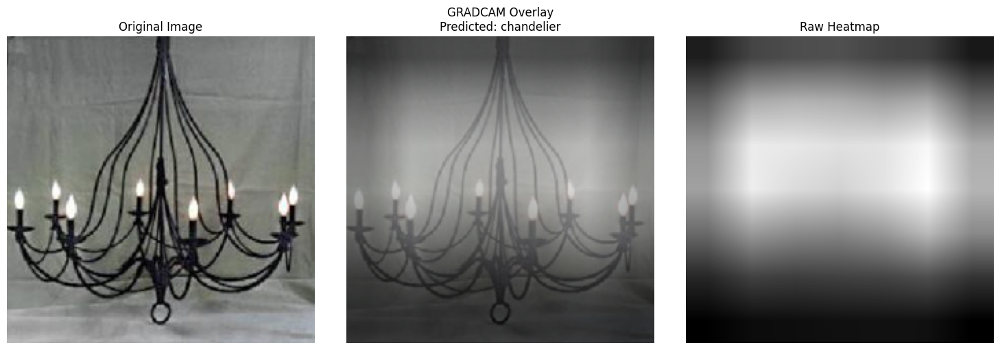

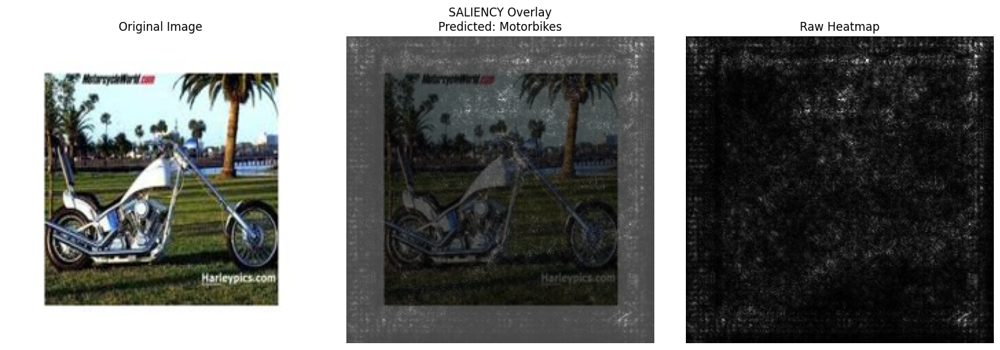

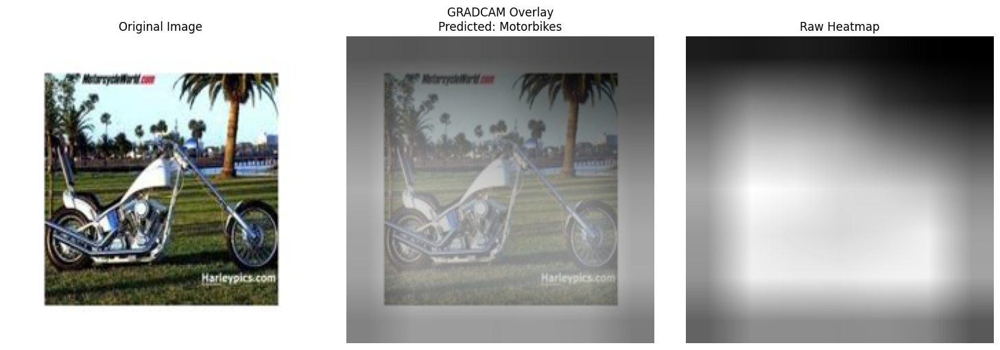

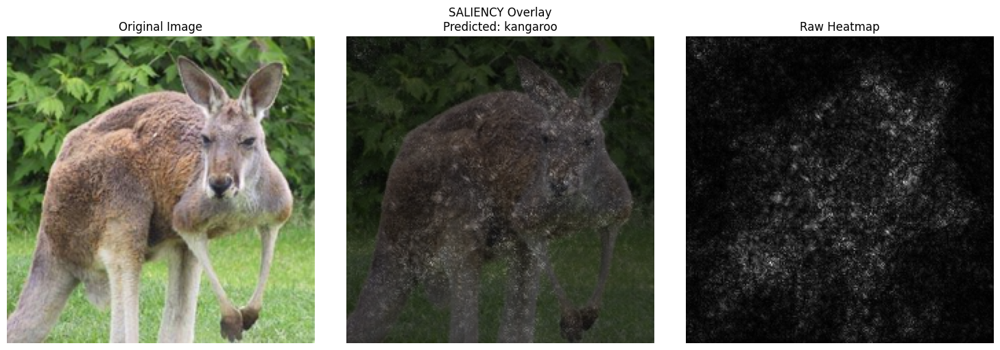

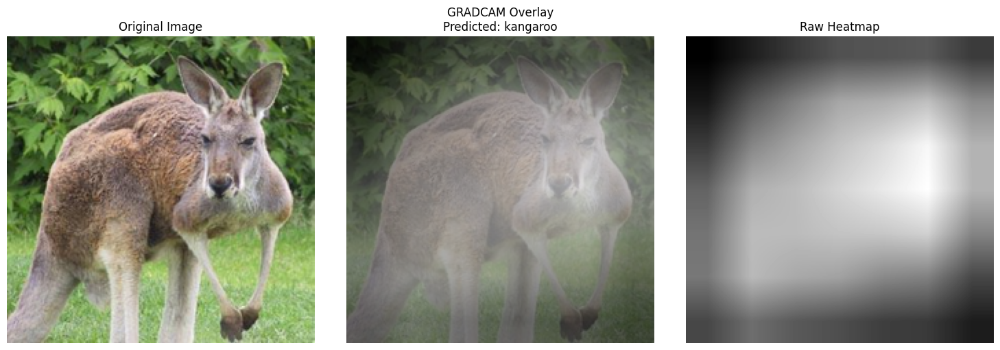

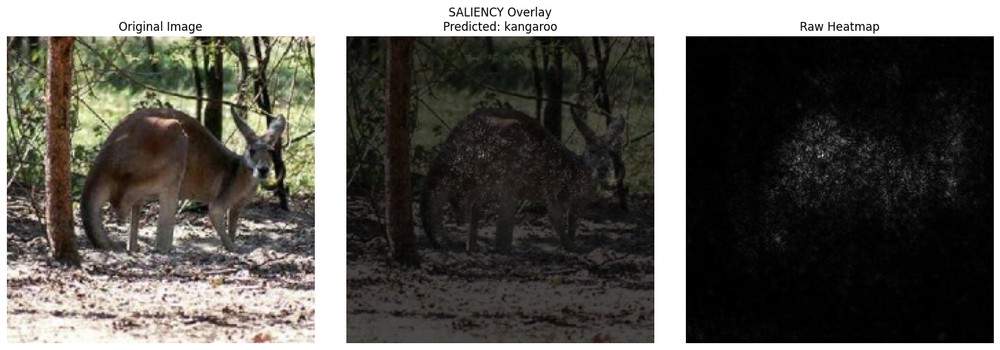

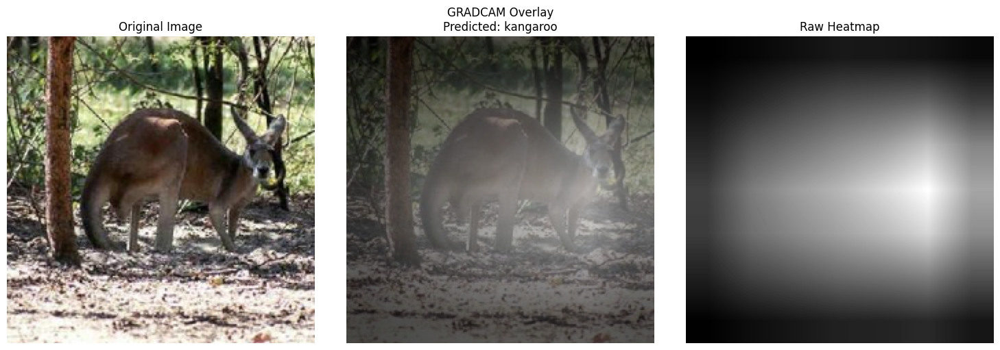

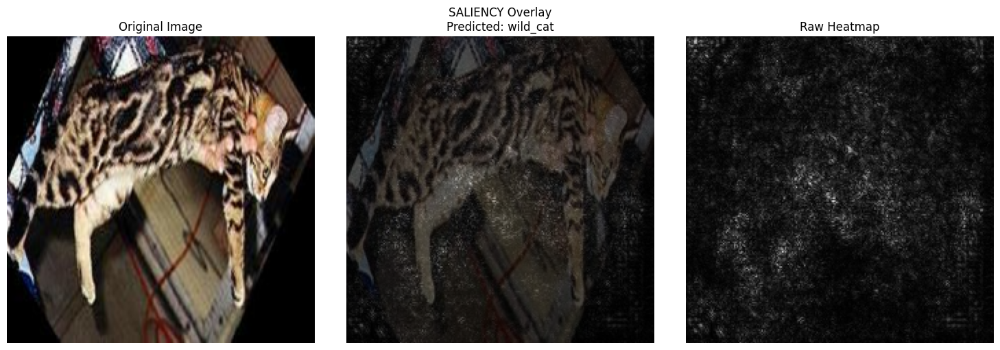

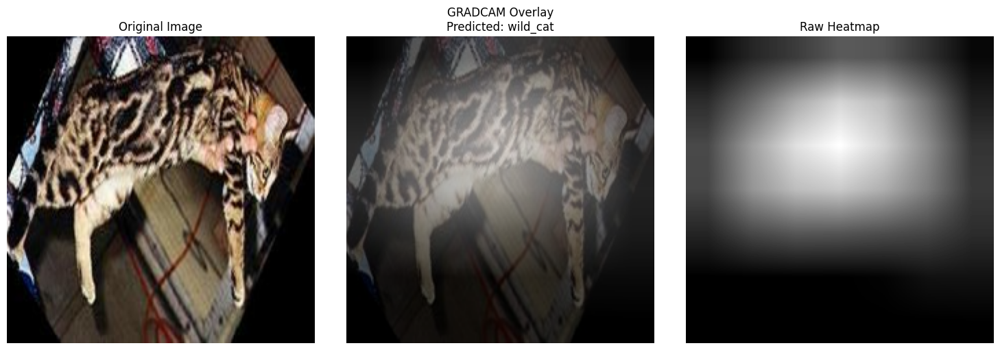

In [34]:
img_paths = df.sample(n=5)['images'].tolist()

for img_path in img_paths:
    explain_prediction(resnet, img_path, classes, method='saliency')
    explain_prediction(resnet, img_path, classes, method='gradcam', target_layer='layer4')

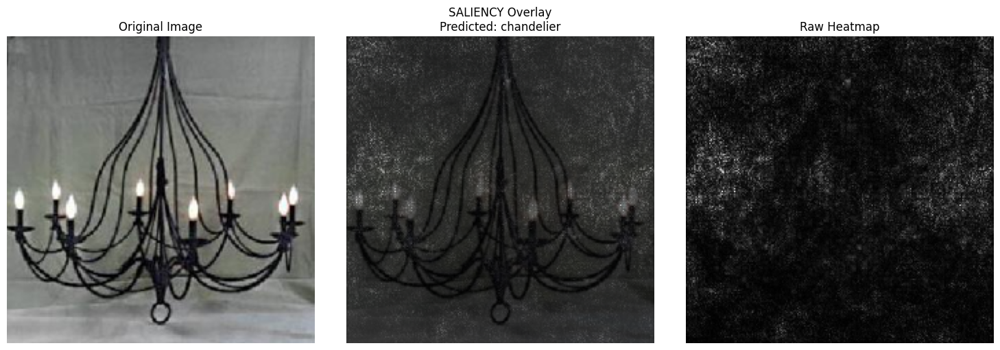

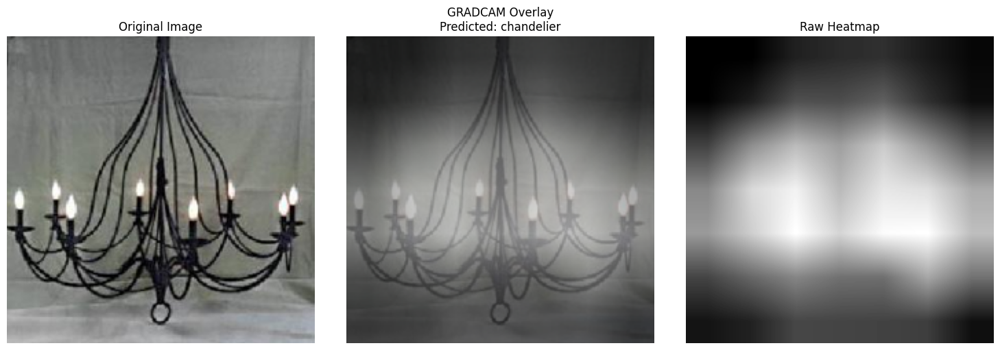

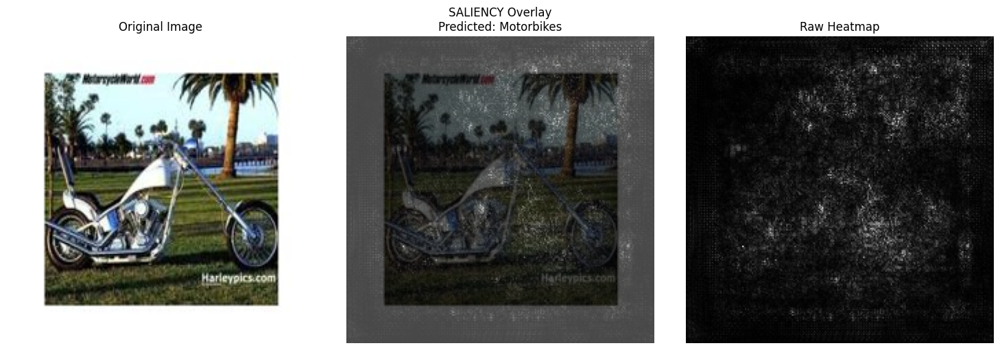

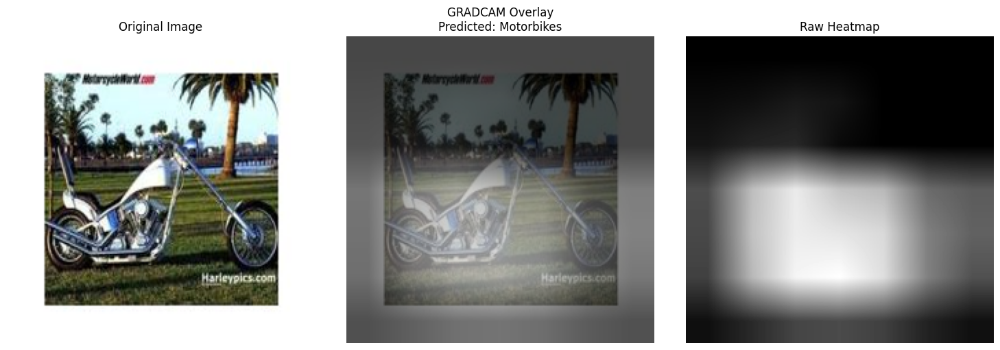

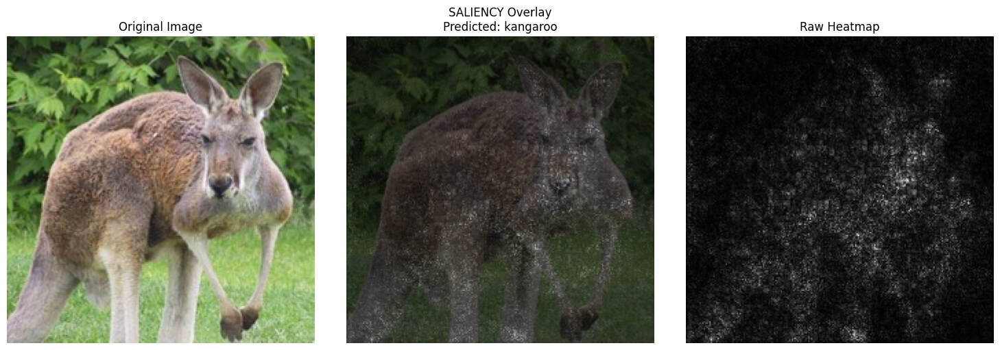

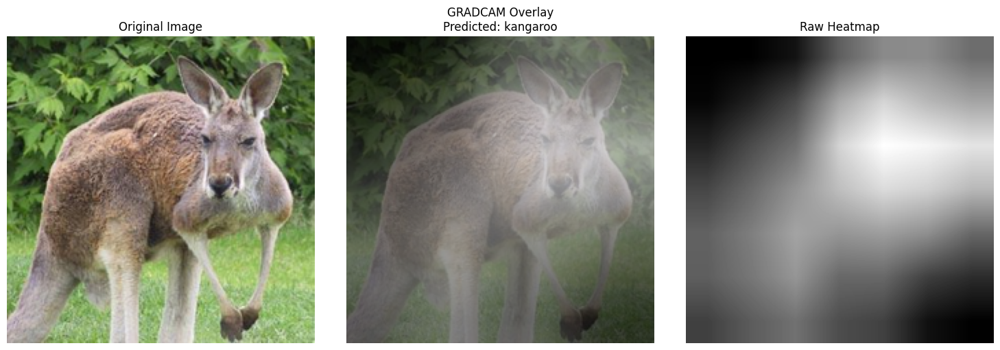

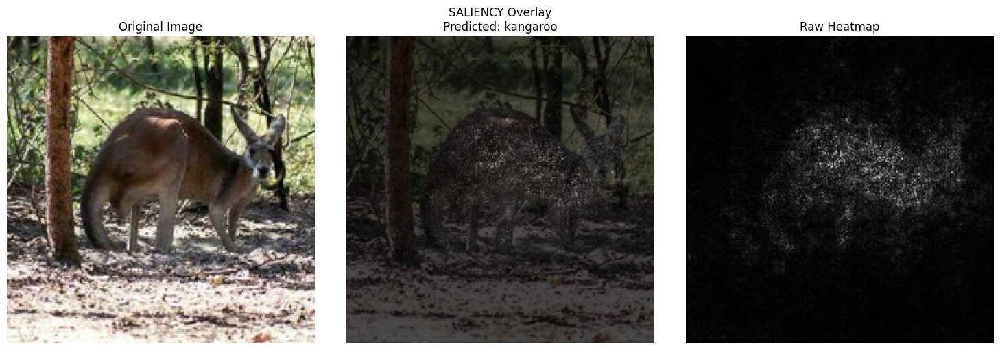

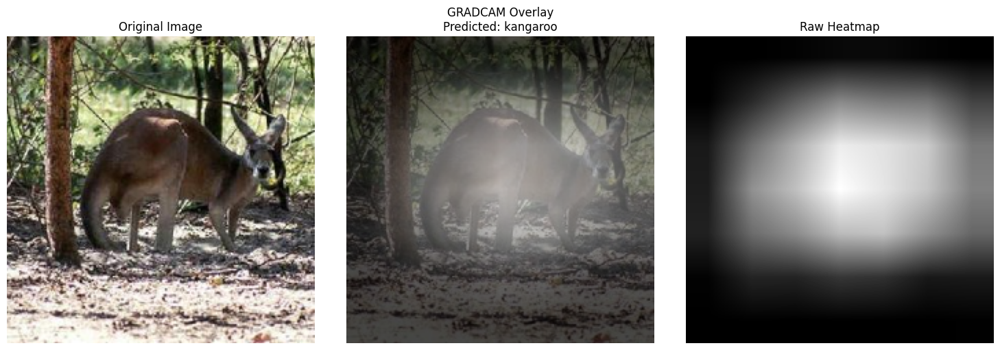

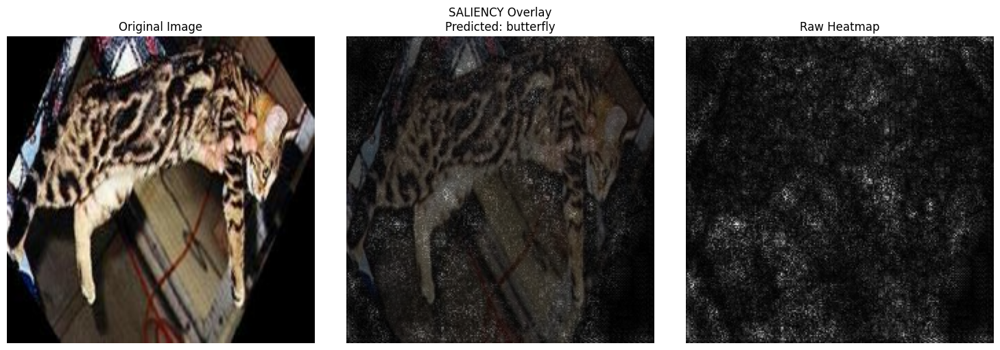

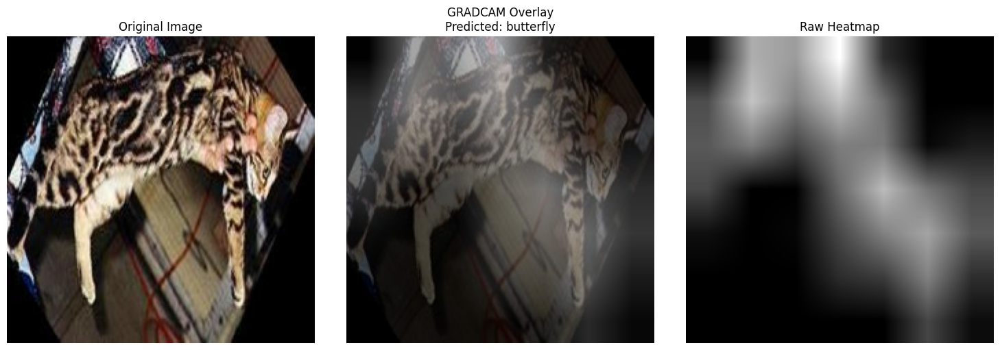

In [35]:
for img_path in img_paths:
    explain_prediction(mobilenet, img_path, classes, method='saliency')
    explain_prediction(mobilenet, img_path, classes, method='gradcam', target_layer='features.18')

# **Phase 4**

In [36]:
def visualize_noise(noise):
    """
    Convert perturbation tensor into a visible image.
    """
    noise_np = noise.squeeze().cpu().numpy()
    noise_np = np.transpose(noise_np, (1, 2, 0))  # C,H,W -> H,W,C
    noise_vis = (noise_np - noise_np.min()) / (noise_np.max() - noise_np.min() + 1e-8)
    noise_vis = (noise_vis * 255).astype(np.uint8)
    return noise_vis

In [37]:
def tensor_to_numpy(tensor, normalize=False):
    """
    Convert a torch tensor (B,C,H,W) or (C,H,W) to a numpy image (H,W,C).
    If normalize=True, scales to [0,1].
    """
    if tensor.dim() == 4:  # batch case -> take first image
        tensor = tensor[0]

    # detach and move to CPU
    img = tensor.detach().cpu().numpy()

    # (C,H,W) -> (H,W,C)
    img = np.transpose(img, (1, 2, 0))

    if normalize:
        img = (img - img.min()) / (img.max() - img.min() + 1e-8)

    return img

In [38]:
def forensic_analysis(model, img_path, classes, method='gradcam', target_layer='layer4', epsilon=0.03):
    """
    Conducts forensic analysis on one image:
    1. Clean prediction + XAI visualization
    2. Adversarial attack + adversarial noise
    3. Adversarial prediction + XAI visualization
    """

    # Load and preprocess clean image
    img_tensor, pil_img = preprocess_image(img_path)  

    # Forward pass on clean image
    clean_output = model(img_tensor)
    clean_class = clean_output.argmax(dim=1).item()

    # Get XAI visualization for clean image
    clean_viz = explain_prediction(model, img_tensor, classes, method=method, target_layer=target_layer)

    # Adversarial attack 
    labels_tensor = torch.tensor([clean_class], dtype=torch.long).to(device)
    adv_img, noise = fgsm_attack(model, img_tensor, labels_tensor, epsilon, nn.CrossEntropyLoss())
    adv_output = model(adv_img)
    adv_class = adv_output.argmax(dim=1).item()

    # Get XAI visualization for adversarial image
    adv_viz = explain_prediction(model, adv_img, classes, method=method, target_layer=target_layer)

    # Convert tensors for visualization
    clean_np = tensor_to_numpy(img_tensor)
    adv_np   = tensor_to_numpy(adv_img)
    noise_np = tensor_to_numpy(noise, normalize=True)

    # Package results
    results = {
        "clean_image": clean_np,
        "clean_class": classes[clean_class],
        "clean_viz": clean_viz,

        "adv_image": adv_np,
        "adv_class": classes[adv_class],
        "adv_viz": adv_viz,

        "noise": noise_np,
        "epsilon": epsilon
    }

    return results

/tmp/ipykernel_36/3985976811.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1).to(tensor.device)
/tmp/ipykernel_36/3985976811.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std = torch.tensor(std).view(-1, 1, 1).to(tensor.device)


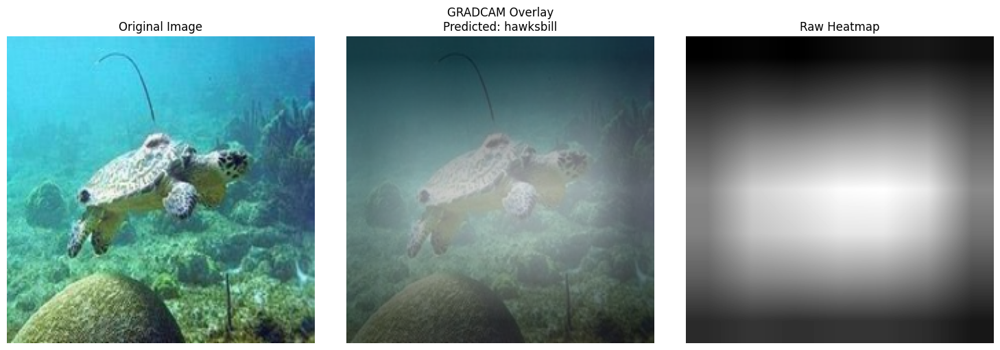

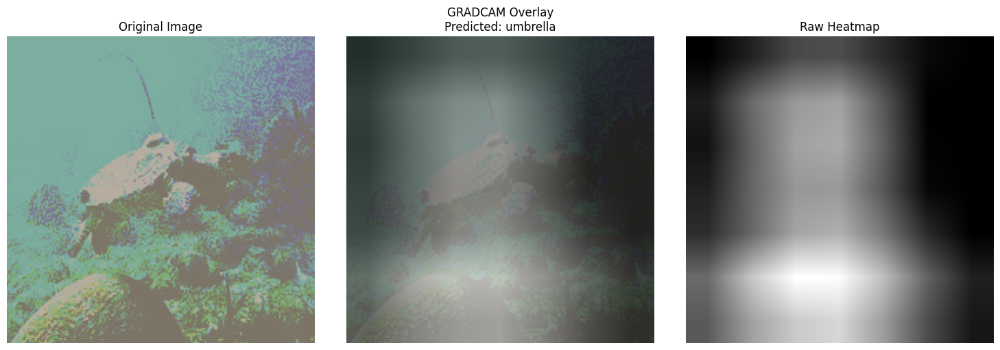

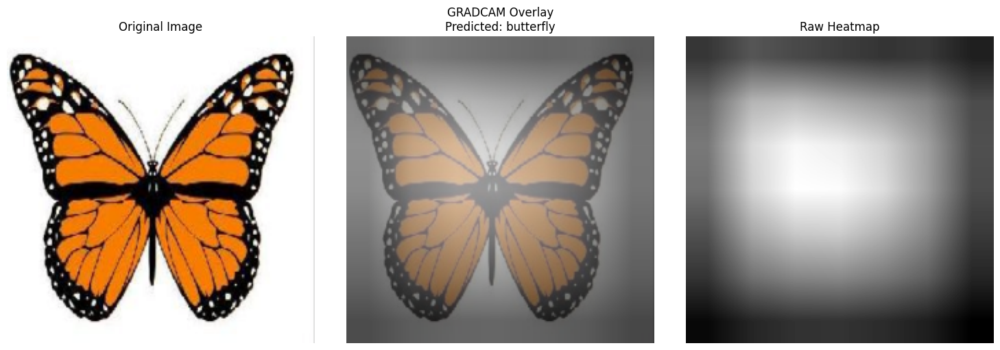

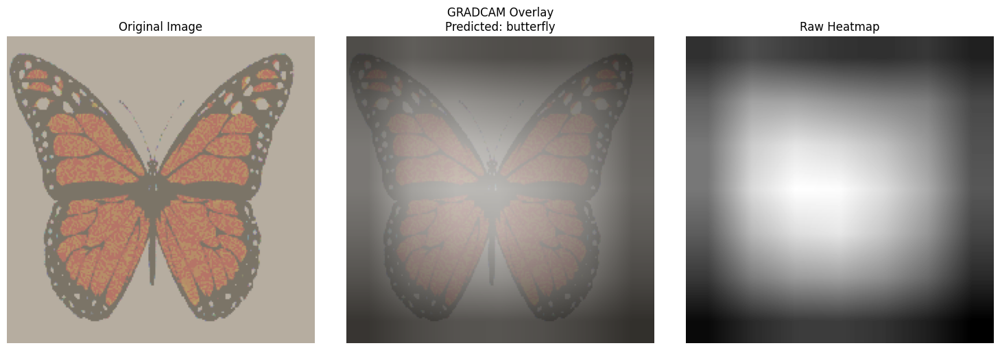

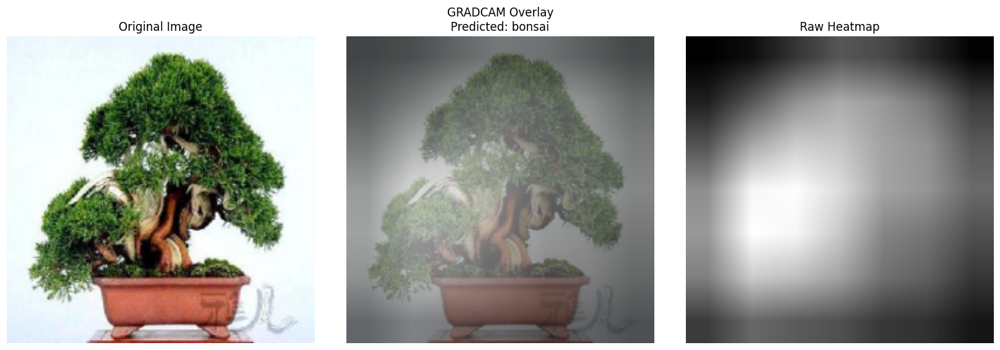

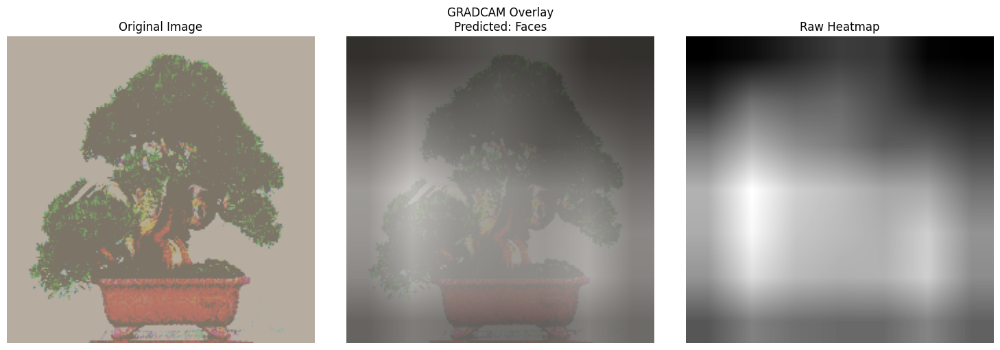

In [52]:
sample_images = df.sample(n=3)['images'].tolist()

for img_path in sample_images:
    results = forensic_analysis(
        resnet, img_path, classes,
        method='gradcam', target_layer='layer4', epsilon=0.3
    )

# **Phase 5**

In [41]:
def adversarial_training(model, train_loader, optimizer, criterion, epsilon, epochs=5):
    model.train()
    for epoch in range(epochs):
        total_loss = 0
        total_correct = 0
        total_samples = 0
        
        for x, y in train_loader:
            x, y = x.to(device), y.to(device)

            # Forward pass on clean images
            outputs = model(x)
            loss = criterion(outputs, y)

            # Generate adversarial examples
            x_adv, _ = fgsm_attack(model, x, y, epsilon, criterion)

            # Forward pass on adversarial images
            outputs_adv = model(x_adv)
            loss_adv = criterion(outputs_adv, y)

            # Combined loss (clean + adversarial)
            total_batch_loss = (loss + loss_adv) / 2

            # Backpropagation
            optimizer.zero_grad()
            total_batch_loss.backward()
            optimizer.step()

            total_loss += total_batch_loss.item() * x.size(0)
            total_correct += (outputs.argmax(1) == y).sum().item()
            total_samples += y.size(0)

        avg_loss = total_loss / total_samples
        avg_acc = 100 * total_correct / total_samples
        print(f"[Epoch {epoch+1}] Loss: {avg_loss:.4f} | Clean Acc: {avg_acc:.2f}%")

In [42]:
# Copy model to harden
hardened_model = copy.deepcopy(resnet).to(device)
optimizer = torch.optim.Adam(hardened_model.parameters(), lr=LR)
criterion = nn.CrossEntropyLoss()

adversarial_training(hardened_model, train_loader, optimizer, criterion, epsilon=0.3, epochs=15)

[Epoch 1] Loss: 0.4726 | Clean Acc: 99.74%
[Epoch 2] Loss: 0.3286 | Clean Acc: 99.75%
[Epoch 3] Loss: 0.2556 | Clean Acc: 99.90%
[Epoch 4] Loss: 0.2153 | Clean Acc: 99.87%
[Epoch 5] Loss: 0.1759 | Clean Acc: 99.84%
[Epoch 6] Loss: 0.1547 | Clean Acc: 99.90%
[Epoch 7] Loss: 0.1283 | Clean Acc: 99.92%
[Epoch 8] Loss: 0.1070 | Clean Acc: 99.93%
[Epoch 9] Loss: 0.0923 | Clean Acc: 99.92%
[Epoch 10] Loss: 0.0844 | Clean Acc: 99.88%
[Epoch 11] Loss: 0.0792 | Clean Acc: 99.88%
[Epoch 12] Loss: 0.0659 | Clean Acc: 99.92%
[Epoch 13] Loss: 0.0666 | Clean Acc: 99.85%
[Epoch 14] Loss: 0.0608 | Clean Acc: 99.93%
[Epoch 15] Loss: 0.0593 | Clean Acc: 99.88%


In [43]:
print("\n=== Original Model Evaluation ===")
evaluate_model(resnet, test_loader, criterion, model_name="Original")
evaluate_under_attack(resnet, test_loader, epsilons=[0.3], loss_fn=criterion)


=== Original Model Evaluation ===
[Original] Test Accuracy: 89.94% | Test Loss: 0.4328
Epsilon=0.3000 | Adv Acc: 23.73% | ASR: 79.49%


In [44]:
print("\n=== Hardened Model Evaluation ===")
evaluate_model(hardened_model, test_loader, criterion, model_name="Hardened")
evaluate_under_attack(hardened_model, test_loader, epsilons=[0.3], loss_fn=criterion)


=== Hardened Model Evaluation ===
[Hardened] Test Accuracy: 90.48% | Test Loss: 0.4098
Epsilon=0.3000 | Adv Acc: 59.14% | ASR: 36.18%


/tmp/ipykernel_36/3985976811.py:5: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  mean = torch.tensor(mean).view(-1, 1, 1).to(tensor.device)
/tmp/ipykernel_36/3985976811.py:6: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  std = torch.tensor(std).view(-1, 1, 1).to(tensor.device)


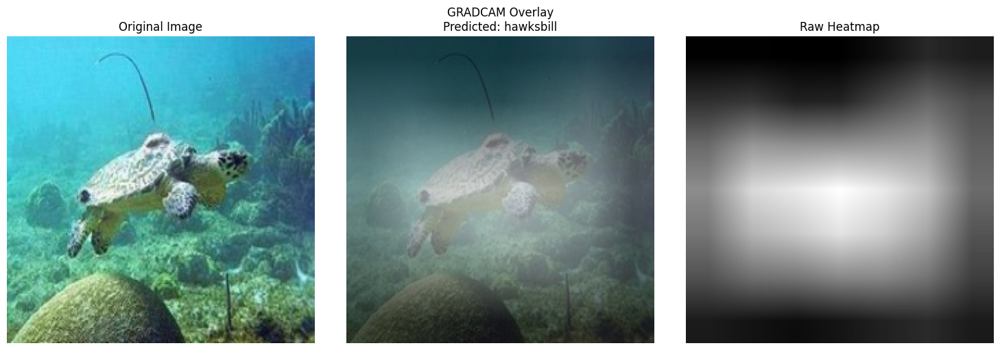

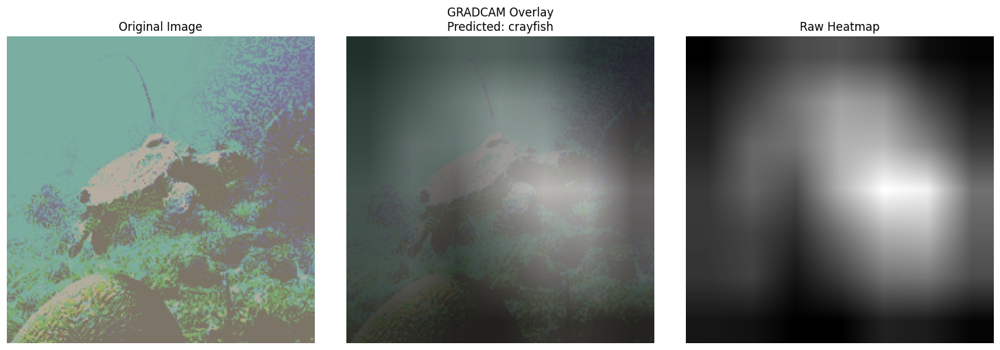

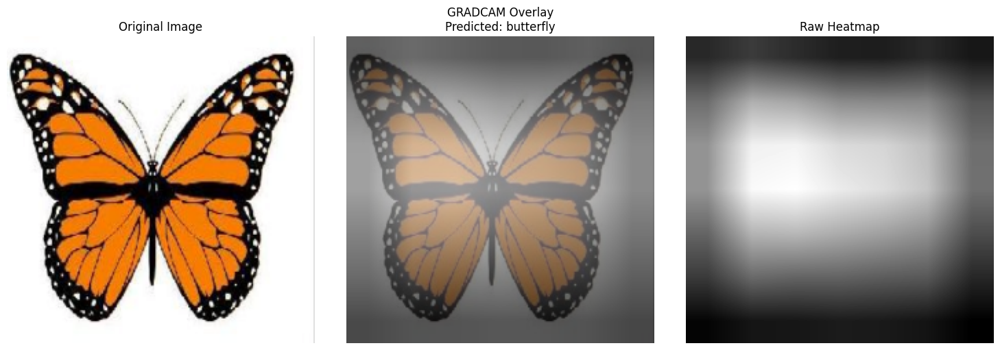

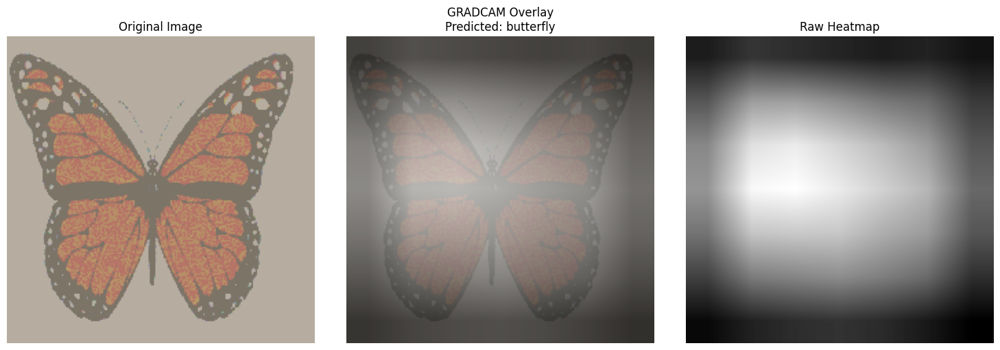

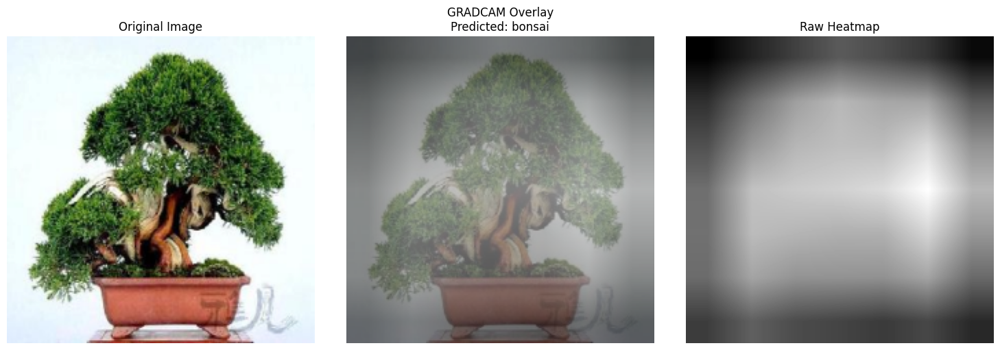

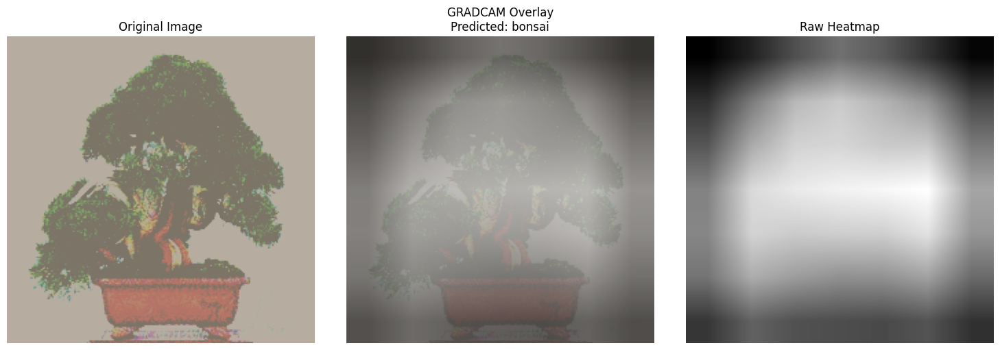

In [53]:
for img_path in sample_images:
    results = forensic_analysis(
        hardened_model, img_path, classes,
        method='gradcam', target_layer='layer4', epsilon=0.3
    )